In [ ]:
# Install packages
!pip install matplotlib-scalebar
!pip install contextily
!pip install libpysal
!pip install esda
!pip install splot
!pip install mgwr

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.5/21.5 MB 26.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.8/2.8 MB 25.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 132.4/132.4 kB 3.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.1/61.1 kB 4.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 331.8/331.8 kB 10.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 215.4/215.4 kB 19.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 47.9/47.9 kB 1.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 41.4/41.4 kB 4.0 MB/s eta 0:00:00


In [ ]:
# Load libraries
import numpy as np
import pandas as pd
pd.set_option('display.max_columns', None)

import matplotlib.pyplot as plt
#plt.style.use('ggplot')
from matplotlib.ticker import FormatStrFormatter
from matplotlib_scalebar.scalebar import ScaleBar
from pylab import rcParams
import matplotlib as mpl
mpl.rcParams['figure.dpi'] = 300

import seaborn as sns
sns.set_style("darkgrid")
sns.set_context(context="paper", font_scale=1.5, rc=None)
sns.set(font="serif")

import plotly.express as px
import plotly.graph_objects as go

import geopandas as gpd

import contextily as cx

import libpysal
from libpysal  import weights
from libpysal.weights import Queen

import esda
from esda.moran import Moran, Moran_Local

import splot
from splot.esda import moran_scatterplot, plot_moran, lisa_cluster, plot_local_autocorrelation
from splot.libpysal import plot_spatial_weights

from giddy.directional import Rose

import statsmodels.api as sm
import statsmodels.formula.api as smf

from spreg import OLS
from spreg import MoranRes
from spreg import ML_Lag
from spreg import ML_Error

from mgwr.gwr import GWR, MGWR
from mgwr.sel_bw import Sel_BW
from mgwr.utils import shift_colormap, truncate_colormap

import warnings
warnings.filterwarnings('ignore')

In [ ]:
df = pd.read_csv("https://raw.githubusercontent.com/eileenCHEN-9/2024e/main/results/Dataset_clubs.csv")
df.head(10)

,id,city,year,trend_lg_agri_predicted,trend_lg_nonagri_predicted,trend_lg_gdppc_predicted,v1,province_id,province,lg_nonagri_predicted,lg_agri_predicted,lg_gdppc_predicted,lg_totalgdp_predicted,club_trend_lg_gdppc_predicted,club_trend_lg_nonagri_predicted,club_trend_lg_agri_predicted,fclub_trend_lg_gdppc_predicted,fclub_trend_lg_nonagri_predicted,fclub_trend_lg_agri_predicted,re_trend_lg_gdppc_predicted,re_trend_lg_nonagri_predicted,re_trend_lg_agri_predicted
0,110000,北京市,2001,4.047992,8.590250,10.394990,302,110000,Beijing,8.543632,4.008240,10.353004,8.554298,2,1.0,23.0,1,1.0,17.0,1.139864,1.561863,1.063533
1,110000,北京市,2002,4.123695,8.703207,10.496782,673,110000,Beijing,8.603212,4.089592,10.403508,8.614112,2,1.0,23.0,1,1.0,17.0,1.136755,1.546255,1.062963
2,110000,北京市,2003,4.199298,8.816047,10.598471,1044,110000,Beijing,8.694524,4.151594,10.464334,8.705110,2,1.0,23.0,1,1.0,17.0,1.133727,1.531373,1.062407
3,110000,北京市,2004,4.274617,8.928404,10.699715,1415,110000,Beijing,8.789451,4.291225,10.571342,8.800518,2,1.0,23.0,1,1.0,17.0,1.130779,1.517205,1.061853
4,110000,北京市,2005,4.349348,9.039608,10.799843,1786,110000,Beijing,9.029587,4.344534,10.797304,9.038776,2,1.0,23.0,1,1.0,17.0,1.127900,1.503730,1.061291
5,110000,北京市,2006,4.423230,9.148641,10.897861,2157,110000,Beijing,9.191402,4.386100,10.943153,9.199555,2,1.0,23.0,1,1.0,17.0,1.125059,1.490901,1.060723
6,110000,北京市,2007,4.495986,9.254459,10.992765,2528,110000,Beijing,9.297535,4.452595,11.035969,9.305372,2,1.0,23.0,1,1.0,17.0,1.122235,1.478685,1.060159
7,110000,北京市,2008,4.567250,9.356128,11.083672,2899,110000,Beijing,9.425365,4.576198,11.153507,9.433168,2,1.0,23.0,1,1.0,17.0,1.119418,1.467064,1.059610
8,110000,北京市,2009,4.636547,9.452819,11.169799,3270,110000,Beijing,9.535016,4.641080,11.259397,9.542480,2,1.0,23.0,1,1.0,17.0,1.116603,1.456025,1.059069
9,110000,北京市,2010,4.703423,9.543878,11.250542,3641,110000,Beijing,9.663707,4.739130,11.362788,9.670946,2,1.0,23.0,1,1.0,17.0,1.113795,1.445564,1.058542


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

In [ ]:
df.columns

Index(['id', 'city', 'year', 'trend_lg_agri_predicted',
       'trend_lg_nonagri_predicted', 'trend_lg_gdppc_predicted', 'v1',
       'province_id', 'province', 'lg_nonagri_predicted', 'lg_agri_predicted',
       'lg_gdppc_predicted', 'lg_totalgdp_predicted',
       'club_trend_lg_gdppc_predicted', 'club_trend_lg_nonagri_predicted',
       'club_trend_lg_agri_predicted', 'fclub_trend_lg_gdppc_predicted',
       'fclub_trend_lg_nonagri_predicted', 'fclub_trend_lg_agri_predicted',
       're_trend_lg_gdppc_predicted', 're_trend_lg_nonagri_predicted',
       're_trend_lg_agri_predicted'],
      dtype='object')

In [ ]:
df.dtypes

id                                   object
city                                 object
year                                  int64
trend_lg_agri_predicted             float64
trend_lg_nonagri_predicted          float64
trend_lg_gdppc_predicted            float64
v1                                    int64
province_id                           int64
province                             object
lg_nonagri_predicted                float64
lg_agri_predicted                   float64
lg_gdppc_predicted                  float64
lg_totalgdp_predicted               float64
club_trend_lg_gdppc_predicted         int64
club_trend_lg_nonagri_predicted     float64
club_trend_lg_agri_predicted        float64
fclub_trend_lg_gdppc_predicted        int64
fclub_trend_lg_nonagri_predicted    float64
fclub_trend_lg_agri_predicted       float64
re_trend_lg_gdppc_predicted         float64
re_trend_lg_nonagri_predicted       float64
re_trend_lg_agri_predicted          float64
Club_total                      

In [ ]:
df['id'] = df['id'].astype(str)
df["Club_total"]= df["fclub_trend_lg_gdppc_predicted"].astype(str)
df["Club_nonagri"]= df["fclub_trend_lg_nonagri_predicted"].astype(str)
df["Club_agri"]= df["fclub_trend_lg_agri_predicted"].astype(str)

In [ ]:
df.describe().round(2)

,year,trend_lg_agri_predicted,trend_lg_nonagri_predicted,trend_lg_gdppc_predicted,v1,province_id,lg_nonagri_predicted,lg_agri_predicted,lg_gdppc_predicted,lg_totalgdp_predicted,club_trend_lg_gdppc_predicted,club_trend_lg_nonagri_predicted,club_trend_lg_agri_predicted,fclub_trend_lg_gdppc_predicted,fclub_trend_lg_nonagri_predicted,fclub_trend_lg_agri_predicted,re_trend_lg_gdppc_predicted,re_trend_lg_nonagri_predicted,re_trend_lg_agri_predicted
count,7340.00,7340.00,7340.00,7340.00,7340.00,7340.00,7340.00,7340.00,7340.00,7340.00,7340.00,7320.00,6520.00,7340.00,7320.00,6520.00,7340.00,7340.00,7340.00
mean,2010.50,4.44,6.58,10.08,3709.31,412152.59,6.58,4.44,10.08,6.74,6.65,5.61,30.55,2.49,3.02,20.67,1.00,1.00,1.00
std,5.77,0.94,1.37,0.78,2142.07,149322.85,1.38,0.95,0.79,1.29,3.65,3.10,17.44,1.02,1.40,10.52,0.06,0.19,0.20
min,2001.00,0.19,1.37,7.63,0.00,110000.00,1.19,0.16,7.57,1.72,1.00,1.00,1.00,1.00,1.00,1.00,0.84,0.25,0.05
25%,2005.75,3.99,5.65,9.53,1854.25,330000.00,5.65,3.98,9.53,5.88,3.00,4.00,17.00,2.00,2.00,14.00,0.96,0.88,0.91
50%,2010.50,4.58,6.57,10.09,3708.50,420000.00,6.58,4.59,10.11,6.74,6.00,5.00,28.00,2.00,3.00,19.00,1.00,0.98,1.05
75%,2015.25,5.07,7.51,10.63,5562.75,520000.00,7.49,5.07,10.65,7.58,9.00,7.00,44.00,3.00,4.00,27.00,1.04,1.14,1.11
max,2020.00,7.07,10.43,12.27,7417.00,650000.00,10.26,7.02,12.12,10.27,15.00,14.00,67.00,6.00,6.00,45.00,1.18,1.59,1.55


In [ ]:
df[df['year']==2010].describe().round(2)

,year,trend_lg_agri_predicted,trend_lg_nonagri_predicted,trend_lg_gdppc_predicted,v1,province_id,lg_nonagri_predicted,lg_agri_predicted,lg_gdppc_predicted,lg_totalgdp_predicted,club_trend_lg_gdppc_predicted,club_trend_lg_nonagri_predicted,club_trend_lg_agri_predicted,fclub_trend_lg_gdppc_predicted,fclub_trend_lg_nonagri_predicted,fclub_trend_lg_agri_predicted,re_trend_lg_gdppc_predicted,re_trend_lg_nonagri_predicted,re_trend_lg_agri_predicted
count,367.0,367.00,367.00,367.00,367.00,367.00,367.00,367.00,367.00,367.00,367.00,366.00,326.00,367.00,366.00,326.00,367.00,367.00,367.00
mean,2010.0,4.44,6.60,10.10,3523.81,412152.59,6.70,4.48,10.19,6.85,6.65,5.61,30.55,2.49,3.02,20.67,1.00,1.00,1.00
std,0.0,0.88,1.24,0.58,106.35,149516.52,1.23,0.88,0.58,1.16,3.66,3.11,17.46,1.02,1.40,10.53,0.06,0.19,0.20
min,2010.0,0.83,2.53,8.59,3339.00,110000.00,2.59,0.87,8.70,3.00,1.00,1.00,1.00,1.00,1.00,1.00,0.85,0.38,0.19
25%,2010.0,4.04,5.83,9.69,3432.50,330000.00,5.90,4.08,9.78,6.12,3.50,4.00,17.00,2.00,2.00,14.00,0.96,0.88,0.91
50%,2010.0,4.64,6.48,10.09,3524.00,420000.00,6.57,4.69,10.17,6.75,6.00,5.00,28.00,2.00,3.00,19.00,1.00,0.98,1.05
75%,2010.0,4.94,7.49,10.46,3615.50,520000.00,7.61,4.97,10.54,7.68,9.00,7.00,44.00,3.00,4.00,27.00,1.04,1.14,1.11
max,2010.0,6.55,9.72,11.60,3707.00,650000.00,9.82,6.59,11.65,9.83,15.00,14.00,67.00,6.00,6.00,45.00,1.15,1.47,1.47


In [ ]:
px.strip(df,
        x = 're_trend_lg_gdppc_predicted',
        hover_name= 'city',
        color='Club_total',
        labels=dict(re_trend_lg_gdppc_predicted="Relative Trend of log GDPpc",
                    Club_total="Convergence club"
                    ),
        animation_frame= 'year')

In [ ]:
px.violin(
    df[df['Club_total']!= 0],
    y="Club_total",
    x="re_trend_lg_gdppc_predicted",
    color="Club_total",
    box=True,
    hover_name= 'city',
    labels=dict(re_trend_lg_gdppc_predicted="Relative Trend of log GDPpc",
                    Club_total="Convergence club"
                    ),
    animation_frame = 'year',
    points="all")

In [ ]:
px.line(
    df,
    x="year",
    y="re_trend_lg_gdppc_predicted",
    color="city",
    hover_name="Club_total",
    hover_data= ['province', 'city'],
    labels=dict(re_trend_lg_gdppc_predicted="Relative Trend of log GDPpc",
                Club_total="Convergence club"
                )
    )

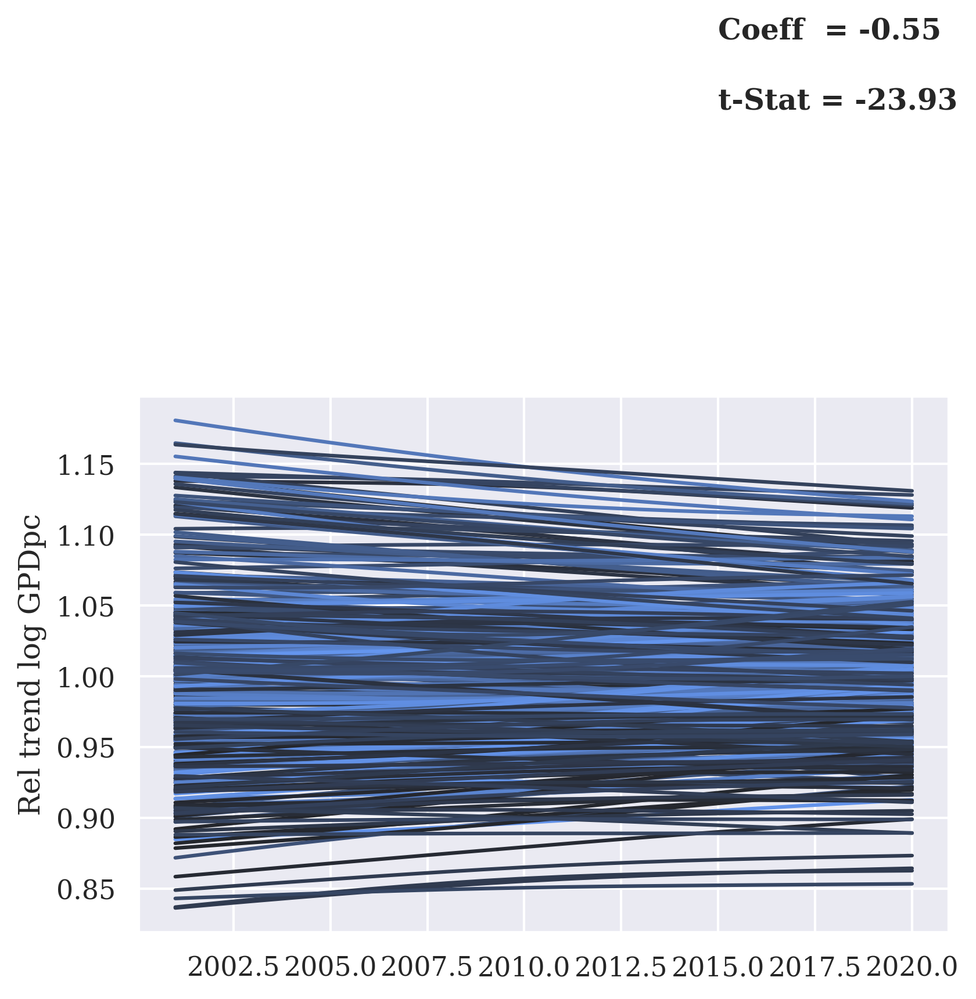

In [ ]:
pal = sns.dark_palette('cornflowerblue', 274)
#pal = sns.dark_palette('seagreen', 274)

f, ax = plt.subplots(nrows=1, ncols=1, figsize=(6,4))
ax = sns.lineplot(x='year', y='re_trend_lg_gdppc_predicted', ci=None, hue='city', data=df, palette=pal, legend = False)
plt.xlabel('')
plt.ylabel('Rel trend log GPDpc')

#plt.text(2003, 1.187, "Inner London West (UK)", size = 8)
plt.text(2015, 1.45, "Coeff  = -0.55", weight = 700)
plt.text(2015, 1.4, "t-Stat = -23.93", weight = 700)

plt.savefig('../content/relGDPpc.png',dpi=300, bbox_inches='tight')
plt.show()

In [ ]:
fig = px.line(
    df[df['Club_total']!= 0],
    x="year",
    y="re_trend_lg_gdppc_predicted",
    color="city",
    hover_name="Club_total",
    hover_data= ['province', 'city'],
    labels=dict(re_trend_ln_gdppc="Relative Trend of log GDPpc",
                Club_total="Convergence club"
                ),
    facet_col="Club_total"
    )
fig.update_layout(showlegend=False)

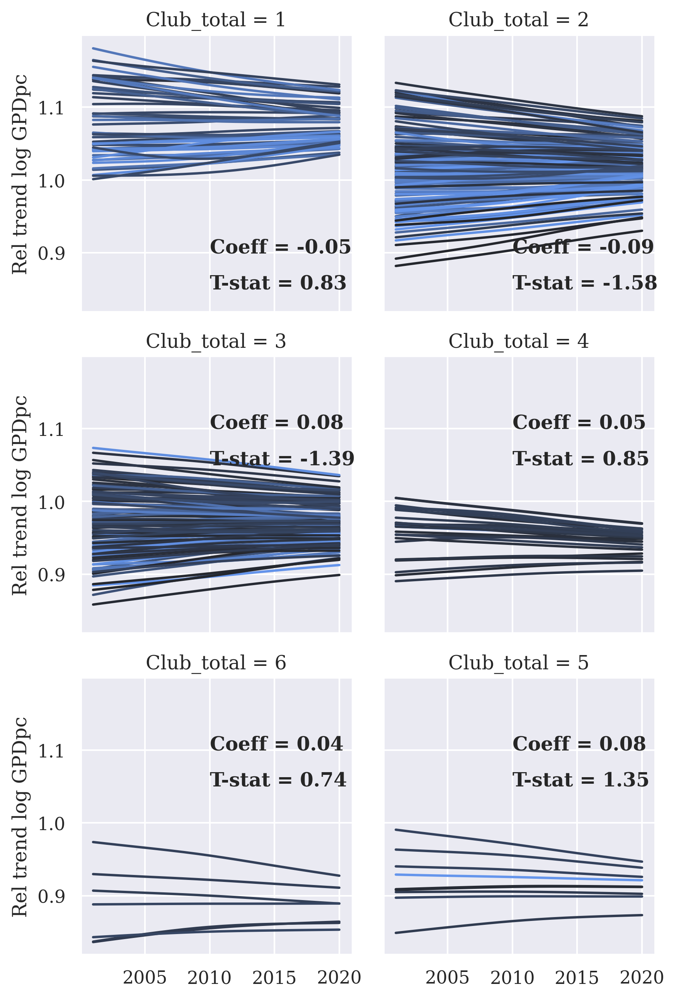

In [ ]:
g = sns.FacetGrid(data= df[df['Club_total']!= 0], col='Club_total', col_wrap=2, hue='city', palette=pal)
g = g.map(sns.lineplot, 'year', 're_trend_lg_gdppc_predicted', ci=None)

ax1 = g.axes[0]
ax2 = g.axes[1]
ax3 = g.axes[2]
ax4 = g.axes[3]
ax5 = g.axes[4]
ax6 = g.axes[5]

ax1.text(2010, 0.9, "Coeff = -0.05", weight = 700)
ax1.text(2010, 0.85, "T-stat = 0.83", weight = 700)
ax2.text(2010, 0.9, "Coeff = -0.09", weight = 700)
ax2.text(2010, 0.85, "T-stat = -1.58", weight = 700)
ax3.text(2010, 1.1, "Coeff = 0.08", weight = 700)
ax3.text(2010, 1.05, "T-stat = -1.39", weight = 700)
ax4.text(2010, 1.1, "Coeff = 0.05", weight = 700)
ax4.text(2010, 1.05, "T-stat = 0.85", weight = 700)
ax5.text(2010, 1.1, "Coeff = 0.04", weight = 700)
ax5.text(2010, 1.05, "T-stat = 0.74", weight = 700)
ax6.text(2010, 1.1, "Coeff = 0.08", weight = 700)
ax6.text(2010, 1.05, "T-stat = 1.35", weight = 700)
g.set_axis_labels('', 'Rel trend log GPDpc')
plt.savefig('../content/Clubs.png',dpi=300, bbox_inches='tight')
plt.show()

# **Wide Panel**

In [ ]:
map = gpd.read_file("/content/市.shp", encoding = "utf-8")

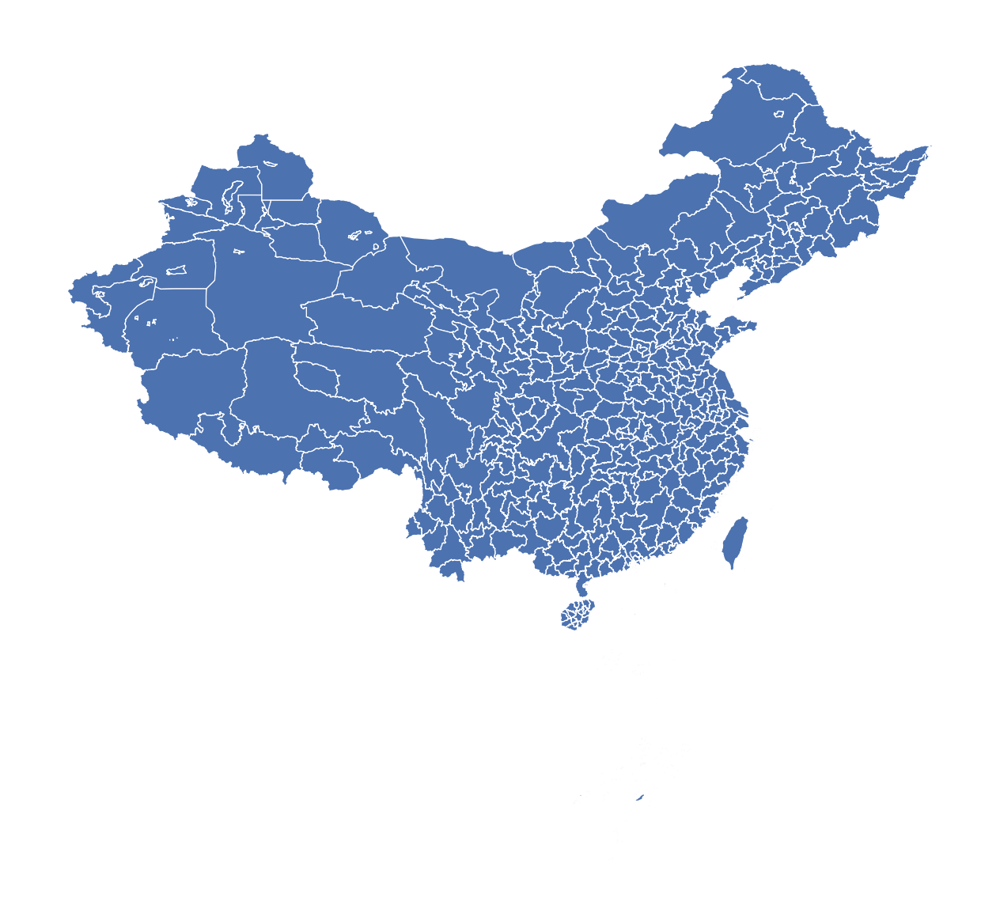

In [ ]:
map.plot(linewidth = 0.3)
plt.axis("off")
plt.show()

In [ ]:
map.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Index: 367 entries, 0 to 370
Data columns (total 7 columns):
 #   Column    Non-Null Count  Dtype   
---  ------    --------------  -----   
 0   省         367 non-null    object  
 1   省代码       367 non-null    int64   
 2   市         367 non-null    object  
 3   市代码       367 non-null    int64   
 4   市类型       367 non-null    object  
 5   省类型       367 non-null    object  
 6   geometry  367 non-null    geometry
dtypes: geometry(1), int64(2), object(4)
memory usage: 22.9+ KB


In [ ]:
drop_province = map['省代码'].isin([810000, 820000, 710000])
dropn_city = map['市代码'] == 460300
rows_to_drop = map[drop_province | dropn_city].index
map = map.drop(rows_to_drop)

In [ ]:
map.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Index: 367 entries, 0 to 370
Data columns (total 7 columns):
 #   Column    Non-Null Count  Dtype   
---  ------    --------------  -----   
 0   省         367 non-null    object  
 1   省代码       367 non-null    int64   
 2   市         367 non-null    object  
 3   市代码       367 non-null    int64   
 4   市类型       367 non-null    object  
 5   省类型       367 non-null    object  
 6   geometry  367 non-null    geometry
dtypes: geometry(1), int64(2), object(4)
memory usage: 22.9+ KB


In [ ]:
df_wide = pd.read_csv("https://raw.githubusercontent.com/eileenCHEN-9/2024e/main/results/Dataset_clubs_wide.csv", encoding = "utf-8")

In [ ]:
df_wide.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 367 entries, 0 to 366
Data columns (total 66 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   id                                367 non-null    int64  
 1   re_gdppc2001                      367 non-null    float64
 2   re_nonagri2001                    367 non-null    float64
 3   re_agri2001                       367 non-null    float64
 4   re_gdppc2002                      367 non-null    float64
 5   re_nonagri2002                    367 non-null    float64
 6   re_agri2002                       367 non-null    float64
 7   re_gdppc2003                      367 non-null    float64
 8   re_nonagri2003                    367 non-null    float64
 9   re_agri2003                       367 non-null    float64
 10  re_gdppc2004                      367 non-null    float64
 11  re_nonagri2004                    367 non-null    float64
 12  re_agri2

In [ ]:
gdf = map.merge(df_wide, left_on = "市代码", right_on = "id", how = "outer")

In [ ]:
gdf.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 367 entries, 0 to 366
Data columns (total 73 columns):
 #   Column                            Non-Null Count  Dtype   
---  ------                            --------------  -----   
 0   省                                 367 non-null    object  
 1   省代码                               367 non-null    int64   
 2   市                                 367 non-null    object  
 3   市代码                               367 non-null    int64   
 4   市类型                               367 non-null    object  
 5   省类型                               367 non-null    object  
 6   geometry                          367 non-null    geometry
 7   id                                367 non-null    int64   
 8   re_gdppc2001                      367 non-null    float64 
 9   re_nonagri2001                    367 non-null    float64 
 10  re_agri2001                       367 non-null    float64 
 11  re_gdppc2002                      367 non-null    

In [ ]:
gdf.explore(
    column='fclub_trend_lg_gdppc_predicted',
    tooltip=['fclub_trend_lg_gdppc_predicted', '省', '市'],
    scheme='naturalbreaks',
    k=6,
    cmap='coolwarm_r',
    legend=True,
    tiles='CartoDB positron',
    style_kwds=dict(color="gray", weight=0.9),
    legend_kwds=dict(colorbar=False, labels=['Club 1', 'Club 2', 'Club 3', 'Club 4', 'Club 5', 'Club 6'])
)

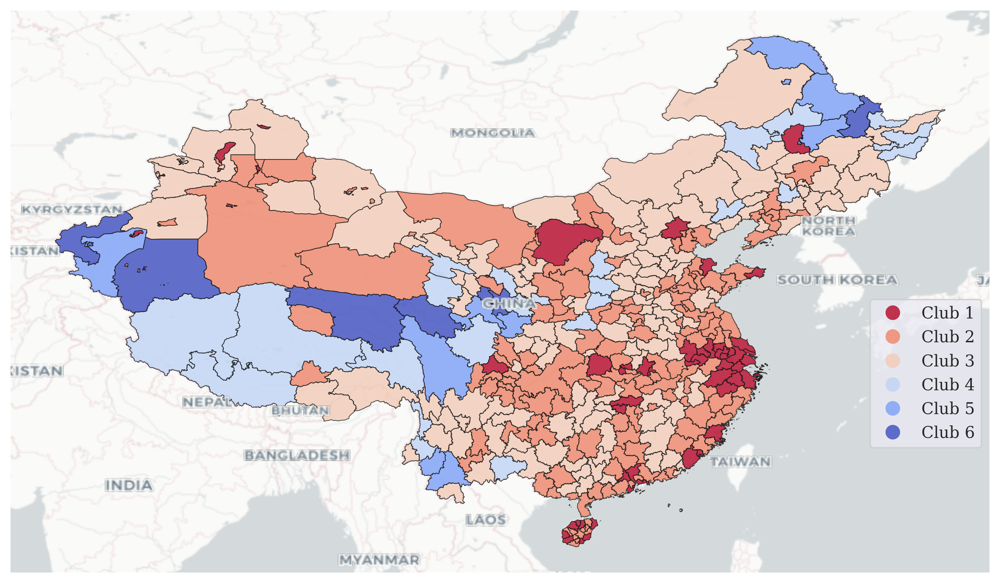

In [ ]:
fig, ax = plt.subplots(figsize=(12, 8))
gdf.plot(column='fclub_trend_lg_gdppc_predicted', edgecolor='k', scheme='NaturalBreaks', k=6, cmap='coolwarm_r', linewidth = 0.5, alpha = 0.8, legend=True, legend_kwds={'bbox_to_anchor':(1., 0.5), 'labels':['Club 1', 'Club 2', 'Club 3', 'Club 4', 'Club 5', 'Club 6']}, ax=ax)

cx.add_basemap(ax, crs=gdf.crs.to_string(), source=cx.providers.CartoDB.Positron, attribution=False)
cx.add_basemap(ax, crs=gdf.crs.to_string(), source=cx.providers.CartoDB.PositronOnlyLabels, attribution=False)

ax.axis("off")

plt.savefig('../content/mapClubs.pdf', dpi=300, bbox_inches='tight')
plt.show()

(70.4226892500001, 138.17533575000002, 16.37342933740008, 55.33458565060009)

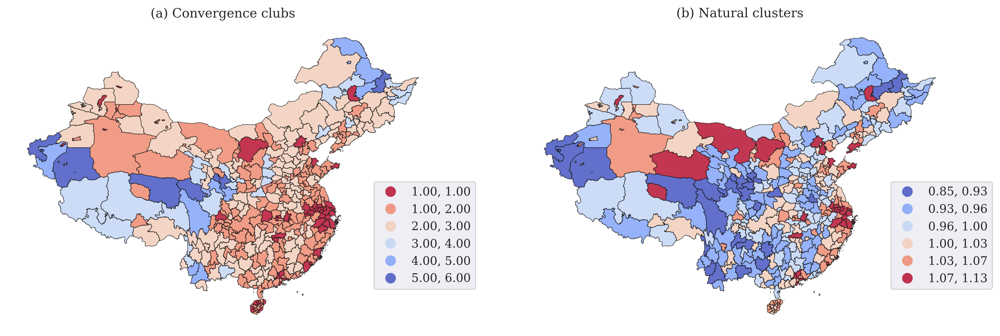

In [ ]:
f,ax = plt.subplots(1,2, figsize=(16, 8))
gdf.plot(column='fclub_trend_lg_gdppc_predicted', ax=ax[0], edgecolor='k',
        scheme='NaturalBreaks', k=6, cmap='coolwarm_r', linewidth = 0.5, alpha = 0.8, legend=True, legend_kwds={'bbox_to_anchor':(1.1, 0.5)})
ax[0].set_title("(a) Convergence clubs")
ax[0].axis("off")
gdf.plot(column='re_gdppc2020', ax=ax[1], edgecolor='k',
        scheme='FisherJenks', k=6, cmap='coolwarm', linewidth = 0.5, alpha = 0.8, legend=True, legend_kwds={'bbox_to_anchor':(1.1, 0.5)})
ax[1].set_title("(b) Natural clusters")
ax[1].axis("off")
#plt.savefig('../results/mapClubs.pdf',dpi=300, bbox_inches='tight');

(70.4226892500001, 138.17533575000002, 16.37342933740008, 55.33458565060009)

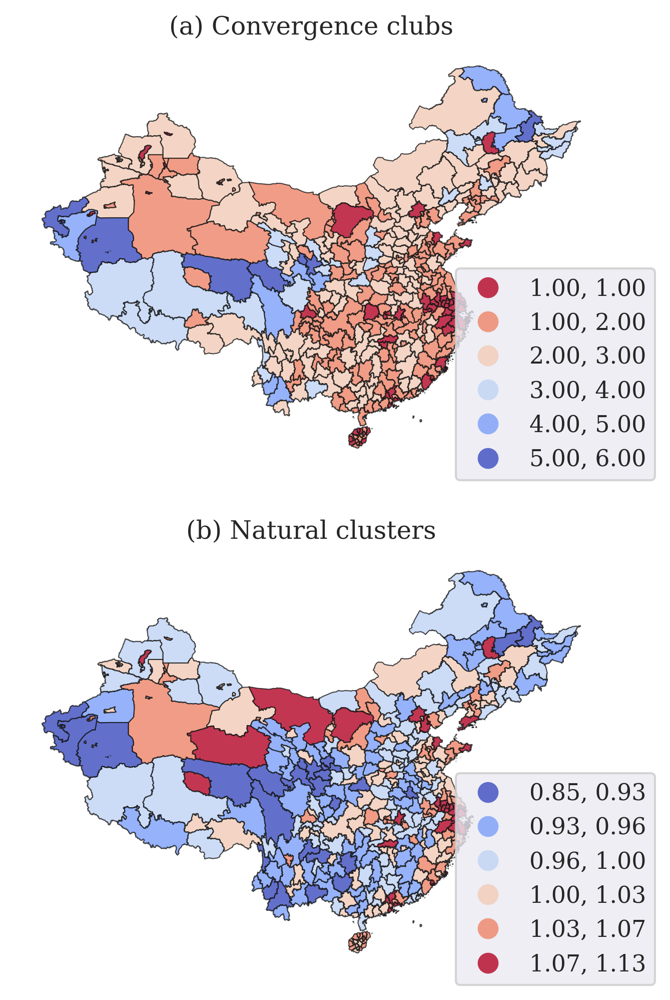

In [ ]:
f,ax = plt.subplots(2,1, figsize=(16, 8))
gdf.plot(column='fclub_trend_lg_gdppc_predicted', ax=ax[0], edgecolor='k',
        scheme='NaturalBreaks', k=6, cmap='coolwarm_r', linewidth = 0.5, alpha = 0.8, legend=True, legend_kwds={'bbox_to_anchor':(1.1, 0.5)})
ax[0].set_title("(a) Convergence clubs")
ax[0].axis("off")
gdf.plot(column='re_gdppc2020', ax=ax[1], edgecolor='k',
        scheme='FisherJenks', k=6, cmap='coolwarm', linewidth = 0.5, alpha = 0.8, legend=True, legend_kwds={'bbox_to_anchor':(1.1, 0.5)})
ax[1].set_title("(b) Natural clusters")
ax[1].axis("off")
#plt.savefig('../content/results/mapClubs.pdf',dpi=300, bbox_inches='tight');

In [ ]:
W = weights.KNN.from_dataframe(gdf, k=5)
W.transform = 'r'

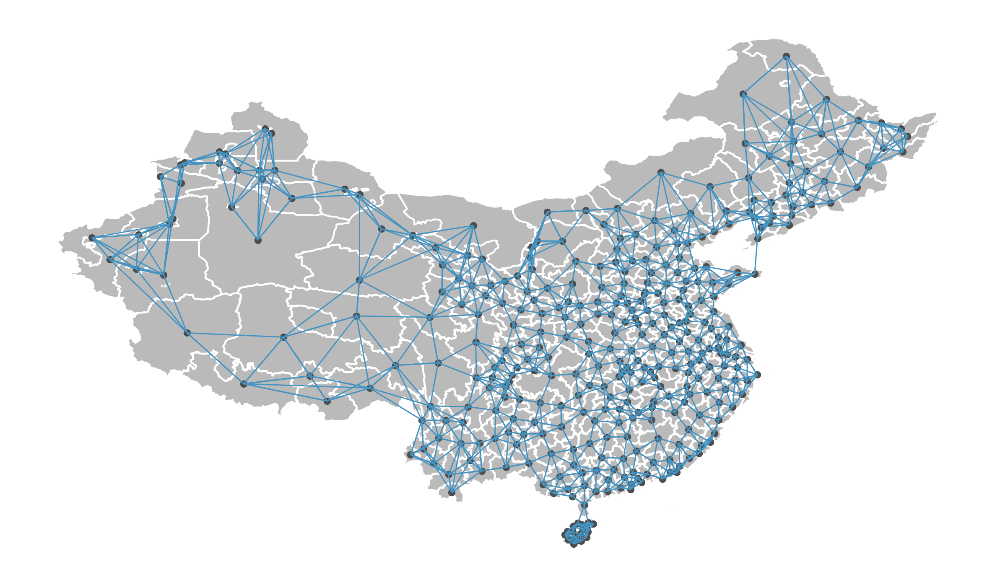

In [ ]:
plot_spatial_weights(W, gdf);

In [ ]:
moran2001 = Moran(gdf["re_gdppc2001"], W)
moran2020 = Moran(gdf["re_gdppc2020"], W)

In [ ]:
print(moran2001.I, moran2020.I)

0.5044911891030682 0.48688836571266186


In [ ]:
print(moran2001.p_sim, moran2020.p_sim)

0.001 0.001


In [ ]:
Lmoran2001 = Moran_Local(gdf["re_gdppc2001"], W, permutations = 999, seed=12345)
Lmoran2020 = Moran_Local(gdf["re_gdppc2020"], W, permutations = 999, seed=12345)

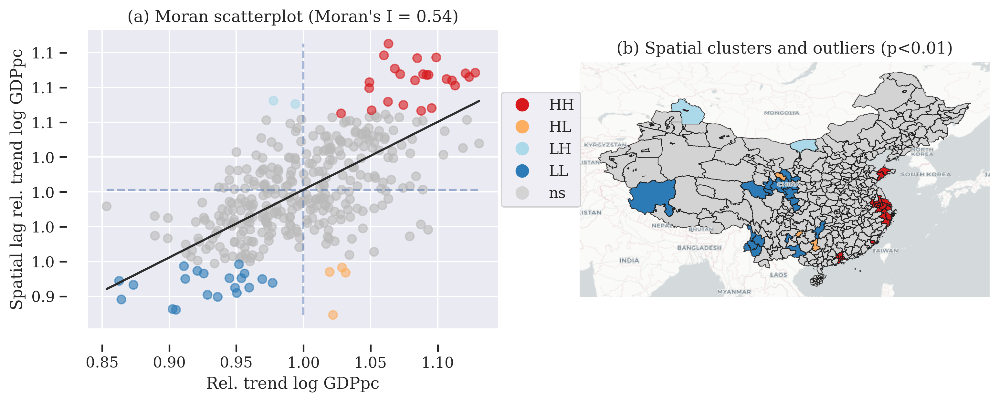

In [ ]:
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(12,4))
moran_scatterplot(Lmoran2020, p=0.01, aspect_equal=False, zstandard = False, ax=axes[0])
lisa_cluster(Lmoran2020, gdf, p=0.01, legend_kwds={'bbox_to_anchor':(0.02, 0.90)},  ax=axes[1])

gdf.geometry.boundary.plot(color=None, edgecolor='k', linewidth=0.5, alpha=0.8, ax=axes[1])
cx.add_basemap(axes[1], crs=gdf.crs.to_string(), source=cx.providers.CartoDB.Positron, attribution=False)
cx.add_basemap(axes[1], crs=gdf.crs.to_string(), source=cx.providers.CartoDB.PositronOnlyLabels, attribution=False)

axes[0].set_xlabel('Rel. trend log GDPpc')
axes[0].set_ylabel('Spatial lag rel. trend log GDPpc')
axes[0].yaxis.set_major_formatter(FormatStrFormatter('%.1f'))
axes[0].set_title("(a) Moran scatterplot (Moran's I = 0.54)")
axes[1].set_title("(b) Spatial clusters and outliers (p<0.01)")
plt.savefig('../content/lisaGDPrel.png',dpi=300, bbox_inches='tight')
plt.show()

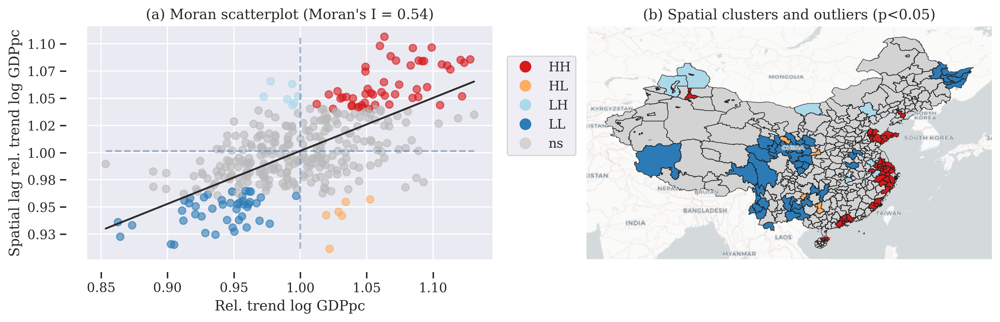

In [ ]:
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(12,4))

moran_scatterplot(Lmoran2020, p=0.05, aspect_equal=False, zstandard = False, ax=axes[0])

lisa_cluster(Lmoran2020, gdf, p=0.05, legend_kwds={'bbox_to_anchor':(-0.01, 0.90)},  ax=axes[1])

gdf.geometry.boundary.plot(color=None, edgecolor='k', linewidth=0.5, alpha=0.8, ax=axes[1])
cx.add_basemap(axes[1], crs=gdf.crs.to_string(), source=cx.providers.CartoDB.Positron, attribution=False)
cx.add_basemap(axes[1], crs=gdf.crs.to_string(), source=cx.providers.CartoDB.PositronOnlyLabels, attribution=False)

axes[0].set_xlabel('Rel. trend log GDPpc')
axes[0].set_ylabel('Spatial lag rel. trend log GDPpc')
axes[0].yaxis.set_major_formatter(FormatStrFormatter('%.2f'))
axes[0].set_title("(a) Moran scatterplot (Moran's I = 0.54)")

axes[1].set_title("(b) Spatial clusters and outliers (p<0.05)")
plt.tight_layout()
plt.savefig('../content/lisaGDPrel.png',dpi=300, bbox_inches='tight')
plt.show()

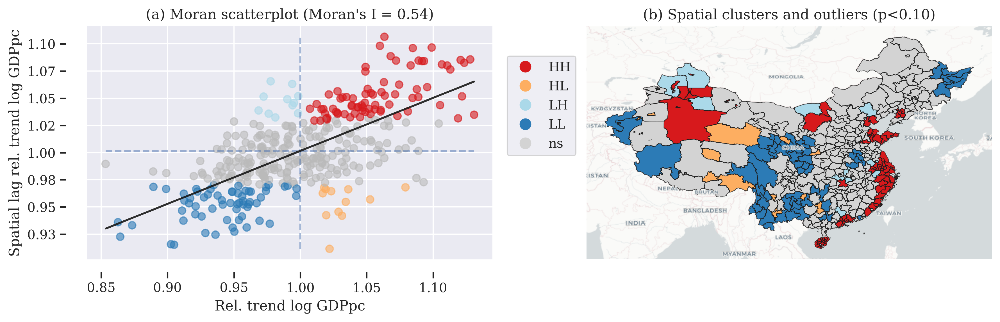

In [ ]:
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(12,4))

moran_scatterplot(Lmoran2020, p=0.10, aspect_equal=False, zstandard = False, ax=axes[0])

lisa_cluster(Lmoran2020, gdf, p=0.10, legend_kwds={'bbox_to_anchor':(-0.01, 0.90)},  ax=axes[1])

gdf.geometry.boundary.plot(color=None, edgecolor='k', linewidth=0.5, alpha=0.8, ax=axes[1])
cx.add_basemap(axes[1], crs=gdf.crs.to_string(), source=cx.providers.CartoDB.Positron, attribution=False)
cx.add_basemap(axes[1], crs=gdf.crs.to_string(), source=cx.providers.CartoDB.PositronOnlyLabels, attribution=False)

axes[0].set_xlabel('Rel. trend log GDPpc')
axes[0].set_ylabel('Spatial lag rel. trend log GDPpc')
axes[0].yaxis.set_major_formatter(FormatStrFormatter('%.2f'))
axes[0].set_title("(a) Moran scatterplot (Moran's I = 0.54)")

axes[1].set_title("(b) Spatial clusters and outliers (p<0.10)")
plt.tight_layout()
#plt.savefig('../content/results/lisaGDPrel.png',dpi=300, bbox_inches='tight')
plt.show()